# Project 3: Panoramic Mosaicing

### What to Submit
Submit this iPython Notebook--containing all your code for the programming exercises below--on [learning suite](https://learningsuite.byu.edu/).

Your notebook file should produce the relevant plots and also provide a short write-up with answers to the questions below.

Please also fill in here the time that each part took you:
* 1. Part A: <span style="color:red;">30 min</span>
* 2. Part B: <span style="color:red;">30 minE</span>
* 3. Part C: <span style="color:red;">8 hours</span>
* 4. Part D: <span style="color:red;">6 hours</span>
* 5. Write-up: <span style="color:red;">10 min</span>

### Programming Exercise

For this assignment, you will be writing a program that creates a panoramic mosaic from 2 or more images.  In general this technique should be applicable to any number of photographs.  The approach described below will work well for collective fields of up to 90 or even 120&deg;, but won't produce ideal results for large fields of view approaching or surpassing 180&deg;.  For large fields of view cylindrical or spherical projection is required.

When we construct a panorama, we assume that all of the photographs were taken from the exact same location and that the images are related by pure rotation (no translation of the camera).  The easiest way to create the panorama is to project all of the photos onto a plane.  One photo must be selected (either manually or by your program) to be the base photo.  The other photos are aligned to this base photo by identifying a homography (a planar warp specified by 4 pairs of source/destination points) relating each pair.  Each of the other images is appropriately warped and composited onto the plane (the base image doesn’t need to be warped).

In describing what you need to do, there will be a running example using the three photos below:


<div style="width:100%;text-align:center;"><img src="Images/example1.png" width=100%></div>
        

### Part A: Find Interest Points/Descriptors in each Input Image
We will be using OpenCV for this project, which you should already have installed.  However, you may need to install the contrib version--which comes seperate due to the SIFT algorithm being patented--by running the command:`pip install opencv-contrib-python`.  A good tutorial on how to use SIFT features in OpenCV is found [here](https://docs.opencv.org/trunk/da/df5/tutorial_py_sift_intro.html).  The first step to registering or aligning two images is to identify locations in each image that are distinctive or stand out.  The `sift.detectAndCompute()` routine produces both these interest points and their corresponding SIFT descriptors.  The first step of producing a panorama is to load all of the relevant images and find the interest points and their descriptors.

See the red circles on each image below indicating the sift keypoints that were found (note that we downsampled the images to 600 x 600 pixels before extracting SIFT).  We scaled the circles according to the scale at which each keypoint was detected at.

<div style="width:100%;text-align:center;"><img src="Images/example2.png" width=100%></div>

### Part B: Matching Features

Next, given the features present in each image, you need to match the features so as to determine corresponding points between adjacent/overlapping images.  [This page](https://docs.opencv.org/trunk/dc/dc3/tutorial_py_matcher.html) provides details to do feature matching using `cv2.BFMatcher()`, analogous to the approach proposed by David Lowe in his original implementation.  Be aware that the resulting match is one directional.  You want to find putative pairs--pairs of points which are each other’s best match (e.g. there might be 3 points in image I1 for which a point q in image I2 are the best match, only one of these could be the best matching point p in I1 for that point q in I2).  In this part you need to compute the set of putative matches between each pair of images.

Look at the pairs of images and the lines showing the estimated matches (putative matches are green lines, one way matches are cyan or blue).

<div style="width:100%;text-align:center;"><img src="Images/example3.png" width=100%></div>

### Part C: Estimating Pairwise Homographies using RANSAC

Use the RANSAC algorithm ([Szeliski](http://szeliski.org/Book/), Ch 6.1.4), estimate the homography between each pair of images.  You will need to decide whether you’re going to manually specify the base image or determine in programmatically.  Along with identifying the base image, you need to figure out the order in which you will composite the other images to the base.

You will need 4 pairs of points to estimate a homography.  Begin by randomly sampling sets of 4 pairs and estimating the corresponding homography for each set.  Instead of the two warping equations that we used earlier in the semester, it is recommended that you use a 3x3 homography (8 unknowns).  You are trying to estimate the homography

$$
\begin{bmatrix}a & b & c\\d & e & f\\g & h & 1\end{bmatrix}
$$

such that a point $(x_s,y_s)$ in the source image is tranformed to a point $(x_t,y_t)$ in the target image as follows

$$
\begin{bmatrix}x_t\\y_t\\1\end{bmatrix} = \begin{bmatrix}a & b & c\\d & e & f\\g & h & 1\end{bmatrix}\begin{bmatrix}x_s\\y_s\\1\end{bmatrix}
$$

Each pair of points will produce three linear equations in (a subset of) the 8 unknowns.  For example, $x_t = x_sa + y_sb + c$.  Four pairs of points (assuming no degeneracies) are sufficient to estimate the homography.  A more robust solution relying on more than four pairs can be obtained using least squares on the overconstrained linear system (solving $Ax = b$, where $x$ is a column vector with the 8 unknowns and you populate rows of $A$ and an entry of $b$ with the linear equations just described).  Note that this solution will **not** always be better.

Because of the homogeneous coordinates, the three equations can be reduced to two equations as follows:

$$
x_t = \frac{ax_s+by_s+c}{gx_s+hy_s+1}, \hspace{5mm}
y_t = \frac{dx_s+ey_s+f}{gx_s+hy_s+1}
$$

For more details, see the [image alignment and stitching slides](https://faculty.cs.byu.edu/~farrell/courses/CS450/slides/alignment_stitching.pdf#page=18).

Below you will find a visualization of the RANSAC estimated homographies.  Images 1, 2, and 3 have dots that are red, green and blue respectively (sorry the dots are a little small), representing the putative pairs.  You can see where the homographies line up very well and in a few places (the middle vertically) they line up slightly less well.

<div style="width:100%;text-align:center;"><img src="Images/example4.png" width=100%></div>

### Part D: Creating the Mosaic

Begin with the base image and warp the remaining images (using the estimated homographies) to composite them onto the base image.

For the ongoing campus example, here are the resulting warped images composited.

<div style="width:100%;text-align:center;"><img src="Images/example5.png" width=75%></div>

And, then with a very simple (but not ideal) compositing operation.

<div style="width:100%;text-align:center;"><img src="Images/example6.png" width=75%></div>

In [79]:
# packages and such
import numpy as np
import cv2 as cv
from random import randint
from copy import deepcopy

import matplotlib.pyplot as plt

import warnings

#suppress warnings
warnings.filterwarnings('ignore')

plt.rcParams['figure.figsize'] = [20,16]
plt.rcParams['axes.titlesize'] = '16'
plt.rcParams['axes.titleweight'] = 'bold'


def just_title(title):
    a = plt.gca()
    a.set_title(title, fontdict={'fontsize': plt.rcParams['axes.titlesize'],
                                 'fontweight': plt.rcParams['axes.titleweight'],
                                 'verticalalignment': 'baseline',
                                 'horizontalalignment': 'center'})
    a.set_xticks([])
    a.set_yticks([])


### Part A: Find Interest Points/Descriptors

In [80]:
def draw_circles(img, keypoints):
    """ Draw a blue circle at each interest point"""
    img_kp = img.copy()  # Create a copy of img
    overlay = img_kp.copy()

    # Iterate over all keypoints and draw a circle on evey point.
    count = 0
    for kp in keypoints:
        x, y = kp.pt 
        sz = int(round(kp.size))
        
        x = int(round(x)) 
        y = int(round(y))
        
        # Draw a cross with (x, y) center
        cv.circle(overlay, (x, y), sz//2, (255,0,0), -1)
        
    alpha = 0.4

    return cv.addWeighted(overlay, alpha, img_kp, 1 - alpha, 0)


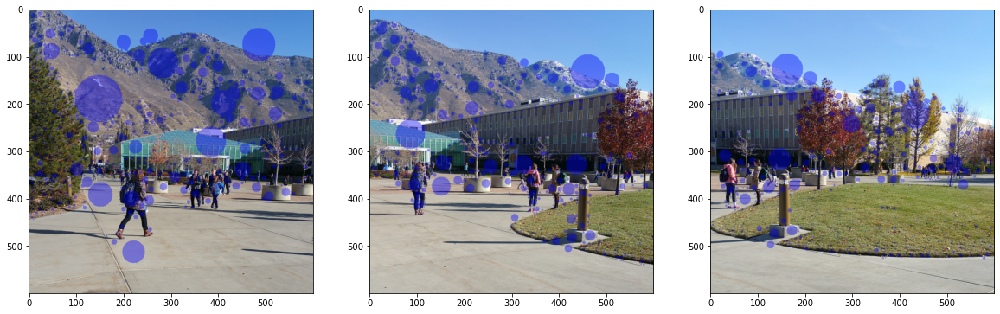

In [81]:
imgs = []
imgs_features = []
kps = []
dess = []
sift = cv.SIFT_create()
for i in range(1, 4):
    img = cv.imread("images/width600/campus" + str(i) + "_sq600.png")
    '''
    h, w, s = img.shape
    sz = min(h, w)
    img = img[:sz,:sz,:] # crop to being square
    print(img.shape)
    img = cv.resize(img, (1200,1200), interpolation=cv.INTER_CUBIC)
    '''
    kp, des = sift.detectAndCompute(img, None)
    kps.append(kp)
    dess.append(des)

    #img = cv.drawKeypoints(img, kp, img)

    kp_img = draw_circles(img, kp)[:,:,::-1]
    imgs_features.append(kp_img)
    imgs.append(img[:,:,::-1])
    
#imgs[1], imgs[2] = imgs[2], imgs[1]
    
plt.subplot(131)
plt.imshow(imgs_features[0])
plt.subplot(132)
plt.imshow(imgs_features[1])
plt.subplot(133)
plt.imshow(imgs_features[2])



### Part B: Matching Features

0 1
2 1
0 2


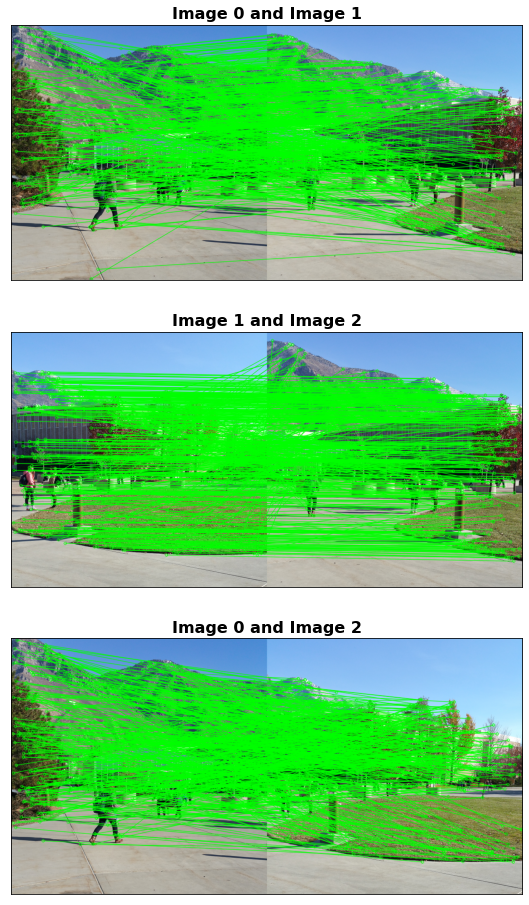

In [82]:

bf = cv.BFMatcher(cv.NORM_L1, crossCheck=True)

matches = []
options = [(0, 1), (2,1), (0,2)]
matches_b = []
for i, j in options:
    matches.append(bf.match(dess[i], dess[j]))
    matches_b.append(bf.match(dess[j], dess[i]))

for i, m in enumerate(matches):
    matches[i] = sorted(m, key = lambda x:x.distance)
    matches_b[i] = sorted(m, key = lambda x:x.distance)
    
    
match_imgs = []
counter = 0
for i, j in options:
    match = matches[counter]
    #match = match[:len(match)//4]
    print(i, j)
    match_imgs.append(cv.drawMatches(imgs[i], kps[i], imgs[j], kps[j], match, None, matchColor=(0,255,0), flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS))
    counter += 1


plt.subplot(311)
plt.imshow(match_imgs[0])
just_title("Image 0 and Image 1")
plt.subplot(312)
plt.imshow(match_imgs[1])
just_title("Image 1 and Image 2")
plt.subplot(313)
plt.imshow(match_imgs[2])
just_title("Image 0 and Image 2")



In [86]:
for m in (matches[2][:50]+matches[2][-50:]):
    if m.imgIdx != 0:
        print(m.imgIdx, m.queryIdx, m.trainIdx)


### Part C: Estimating Pairwise Homographies using RANSAC

In [87]:
def distance_between(pt1, pt2):
    try:
        x2 = np.power((pt1[0]-pt2[0]), 2)
        y2 = np.power((pt1[1]-pt2[1]), 2)
        result = np.sqrt(x2+y2)
    except:
        return np.inf
    return result

def triangle_area(pt1, pt2, pt3):
    # calculates the area of the triangle formed by these three points
    triangle_area = pt1[0] * (pt2[1] - pt3[1]) + \
                    pt2[0] * (pt3[1] - pt1[1]) + \
                    pt3[0] * (pt1[1] - pt2[1])
    return abs(triangle_area)

def colinear(pt1, pt2, pt3, threshold=3000):
    # if they are in a straight line then the area would be 0
    # since zero is practically impossible I calculate if the area
    # is within some relatively small threshold
    tri_area = triangle_area(pt1, pt2, pt3)
    ret_val = True if tri_area < threshold else False
    return ret_val

def all_points(matches, kps1, kps2):
    pts = []
    for i, match in enumerate(matches):
        query_i, train_i = match.queryIdx, match.trainIdx
        from_ = np.array([int(round(e)) for e in kps1[query_i].pt])
        to_ = np.array([int(round(e)) for e in kps2[train_i].pt])
        pt = np.array([from_, to_])
        # add it to the list of points
        pts.append(pt)
        
    return np.array(pts)

def random_points(matches, kps1, kps2, n=4, printing=False, check_colinear=True):
    pts = []
    counter = 0
    indexes = set()
    while len(pts) < n:
        # get a random point from the matches
        ran_i = randint(0,len(matches)-1)
        if ran_i in indexes:
            continue
        indexes.add(ran_i)
        match = matches[ran_i]
        query_i, train_i = match.queryIdx, match.trainIdx
        from_ = [int(round(e)) for e in kps1[query_i].pt]
        to_ = [int(round(e)) for e in kps2[train_i].pt]
        pt = [from_, to_]
        # add it to the list of points
        pts.append(pt)
        
        
        if check_colinear:
            # if three or more points, specify each set of three
            # points that are available to pick
            if len(pts) == 3:
                options = [(0,1,2)]
            elif len(pts) == 4:
                options = [(0,1,2), (0,1,3), (0,2,3), (1,2,3)]
            else:
                continue
            
            # if colinear remove the last point added
            for a,b,c in options:
                # check pic1 points for colinearity
                if colinear(pts[a][0], pts[b][0], pts[c][0]):
                    if printing:
                        print("Found a colinear 'from' point and popped")
                        print(pts[a][0], pts[b][0], pts[c][0])
                        print(triangle_area(pts[a][0], pts[b][0], pts[c][0]))
                    
                    pts.pop(0)
                    break
                # check pic2 points for colinearity
                if colinear(pts[a][1], pts[b][1], pts[c][1]):
                    if printing:
                        print("Found a colinear 'to' point and popped")
                        print(pts[a][1], pts[b][1], pts[c][1])
                        print(triangle_area(pts[a][1], pts[b][1], pts[c][1]))
                    
                    pts.pop(0)
                    break
            
    return np.array(pts)

def homography_matr(pts):
    # finds the 3x3 homography matrix between two sets of points
    if len(pts) != 4:
        raise ValueError(
            "Did not get 4 points as needed, got {} points instead".format(len(pts)))
        
    x1, x2, x3, x4 = pts[0][0][0], pts[1][0][0], pts[2][0][0], pts[3][0][0]
    y1, y2, y3, y4 = pts[0][0][1], pts[1][0][1], pts[2][0][1], pts[3][0][1]
    x1_, x2_, x3_, x4_ = pts[0][1][0], pts[1][1][0], pts[2][1][0], pts[3][1][0]
    y1_, y2_, y3_, y4_ = pts[0][1][1], pts[1][1][1], pts[2][1][1], pts[3][1][1]
    
    A = np.array([[x1, y1, 1, 0, 0, 0, -x1_*x1, -x1_*y1],
                  [0, 0, 0, x1, y1, 1, -y1_*x1, -y1_*y1],
                  [x2, y2, 1, 0, 0, 0, -x2_*x2, -x2_*y2],
                  [0, 0, 0, x2, y2, 1, -y2_*x2, -y2_*y2],
                  [x3, y3, 1, 0, 0, 0, -x3_*x3, -x3_*y3],
                  [0, 0, 0, x3, y3, 1, -y3_*x3, -y3_*y3],
                  [x4, y4, 1, 0, 0, 0, -x4_*x4, -x4_*y4],
                  [0, 0, 0, x4, y4, 1, -y4_*x4, -y4_*y4]])
    
    b = np.array([x1_, y1_, x2_, y2_, x3_, y3_, x4_, y4_])
    
    return np.append(np.linalg.lstsq(A, b)[0], 1).reshape(3,3)
    #return np.append(np.linalg.solve(A, b), 1).reshape(3, 3)

def homography_points(hom_matr, pts):
    # computes the predicted points from the homography
    # matrix and a set of from points
    res_pts = []
    for pt in pts:
        p = np.append(pt, 1)
        # compute the new points through the homography
        # matrix
        res_pt = np.matmul(hom_matr, p)
        res_pts.append(res_pt)
    
    # reformat the predicted points by dividing by w
    # and converting to an integer
    res_pts = np.array(res_pts)
    for i, p in enumerate(res_pts):
        res_pts[i] = res_pts[i] / p[2]
        res_pts[i] = np.rint(res_pts[i])
    res_pts = res_pts.astype(int)[:,:2]
    return res_pts

def info(arr):
    '''Gets relavent statistic information regarding a
    numpy array filled with numerical data'''
    
    class Info():
        def __init__(self, arr):
            arr = arr[np.logical_not(np.isnan(arr))]
            mid = len(arr)//2
            quar = len(arr)//4
            arr_sorted = sorted(arr)
            self.mean = arr.mean()
            self.std = arr.std()
            self.min = arr_sorted[0]
            self.max = arr_sorted[-1]
            self.med = arr_sorted[mid]
            self.p25 = arr_sorted[quar]
            self.p50 = arr_sorted[mid]
            self.p75 = arr_sorted[mid+quar]
        def __lt__(self, other):
            if type(other) == type(None):
                return True
            return self.p75 < other.p75
        def __str__(self):
            string = ""
            string += "Mean: {}\n".format(self.mean)
            string += "Std: {}\n".format(self.std)
            string += "Min: {}\n".format(self.min)
            string += "Max: {}\n".format(self.max)
            string += "Median: {}\n".format(self.med)
            string += "25%: {}\n".format(self.p25)
            string += "50%: {}\n".format(self.p50)
            string += "75%: {}\n".format(self.p75)
            return string
    return Info(arr)
    

def test_the_above_functions():
    pts = random_points(matches[0], kps[0], kps[1])
    print("Points: \n{}\n".format(pts))
    from_pts = pts[:,0]
    to_pts = pts[:,1]
    print("From Points: \n{}\n".format(from_pts))
    print("To Points: \n{}\n".format(to_pts))
    hom_matr = homography_matr(pts)
    print("Hom Matr: \n{}\n".format(hom_matr))
    res_pts = homography_points(hom_matr, from_pts)
    print("Res Points: \n{}\n".format(res_pts))
    print(type(res_pts[0][0]))
    
def hom_from_consensus(consensus):
    start = consensus[0]
    pt1, pt2 = start[0], start[1]
    x = pt1[0]
    y = pt1[1]
    xp = pt2[0]
    yp = pt2[1]
    row = np.array([[x, y, 1, 0, 0, 0, -xp*x, -xp*y],
                    [0, 0, 0, x, y, 1, -yp*x, -yp*y]])
    pts_p = np.array([xp, yp])
    A = row.copy()
    b = pts_p.copy()
    for pt1, pt2 in consensus[1:]:
        x = pt1[0]
        y = pt1[1]
        xp = pt2[0]
        yp = pt2[1]
        row = np.array([[x, y, 1, 0, 0, 0, -xp*x, -xp*y],
                        [0, 0, 0, x, y, 1, -yp*x, -yp*y]])
        pts_p = np.array([xp, yp])
        A = np.append(A, row, axis=0)
        b = np.append(b, np.array([xp, yp]))
    
    #print(consensus[:4])
    #print(A[:10])
    #print(b[:10])
    H = np.append(np.linalg.lstsq(A, b)[0], 1).reshape(3, 3)
    return H

def ransac_homography(matches, kps1, kps2, printing=False):
    '''uses the ransac algorithm to find the optimal
    homography to translate one image to another
    '''
    print("Finding the homography", end = " ")
    best_H = None
    best_close = 0
    consensus = np.array([])
    for j in range(1000):
        
        # random 4 points
        pts = random_points(matches, kps1, kps2, printing=printing)
        pts_test = all_points(matches, kps1, kps2)
        # compute the homography matrix from these 4 points
        H = homography_matr(pts)
        
        # get how far away the distances of the predicted points
        # are from the actual points
        results = homography_points(H, pts_test[:,0])
        distances = []
        for i, p in enumerate(pts_test):
            distances.append(distance_between(p[1], results[i]))
        distances = np.array(distances)
        
        # check how many points follow this homography
        close = len(distances[distances < 5])
        # update if this is a better homography
        if close > best_close:
            best_H = deepcopy(H)
            best_close = close
            consensus = pts_test[distances < 5]
            #print(close, end = " ")
            print("_",end="")
            
        if j % 50 == 0:
            print(".", end=" ")
    print(" Finished")
    print(len(matches), len(consensus))
    
    H = hom_from_consensus(consensus)
            
    return H, consensus



In [88]:
# find the three homography matrices
Hs = []
consensi = []
counter = 0
for x, y in options:
    H, consensus = ransac_homography(matches[counter], kps[x], kps[y])
    Hs.append(H)
    consensi.append(consensus)
    counter += 1

for i, (x, y) in enumerate(options):
    print("Homography matrix from image {} to image {}:\n{}".format(
        x, y, Hs[i]))


Finding the homography _. _____. _. . . . . . . . . . . . . . . . . .  Finished
634 311
Finding the homography _. ___. _. _. . . . . . . . . . . . . . . . _.  Finished
583 274
Finding the homography _. __. _. . . . . . . . . . . . . . . . . .  Finished
529 7
Homography matrix from image 0 to image 1:
[[ 1.24618742e+00  6.47271124e-02 -4.00630794e+02]
 [ 1.34453082e-01  1.18696885e+00 -8.08529782e+01]
 [ 3.95355224e-04  8.89233260e-06  1.00000000e+00]]
Homography matrix from image 2 to image 1:
[[ 7.73628238e-01 -1.14287350e-02  3.08505749e+02]
 [-1.43956673e-01  9.52870105e-01  2.84769670e+01]
 [-4.07793807e-04  2.09179496e-05  1.00000000e+00]]
Homography matrix from image 0 to image 2:
[[-4.11915618e-02 -3.83604982e-01  8.90534113e+01]
 [-3.24183094e-01 -1.26484874e+00  3.34579001e+02]
 [-9.11702257e-04 -3.81270134e-03  1.00000000e+00]]


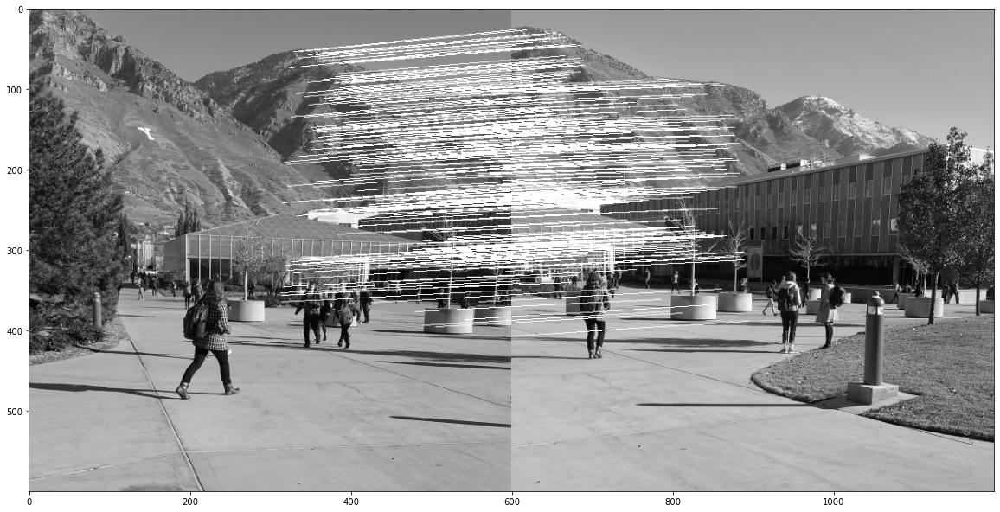

Consensus Sets
--------------------


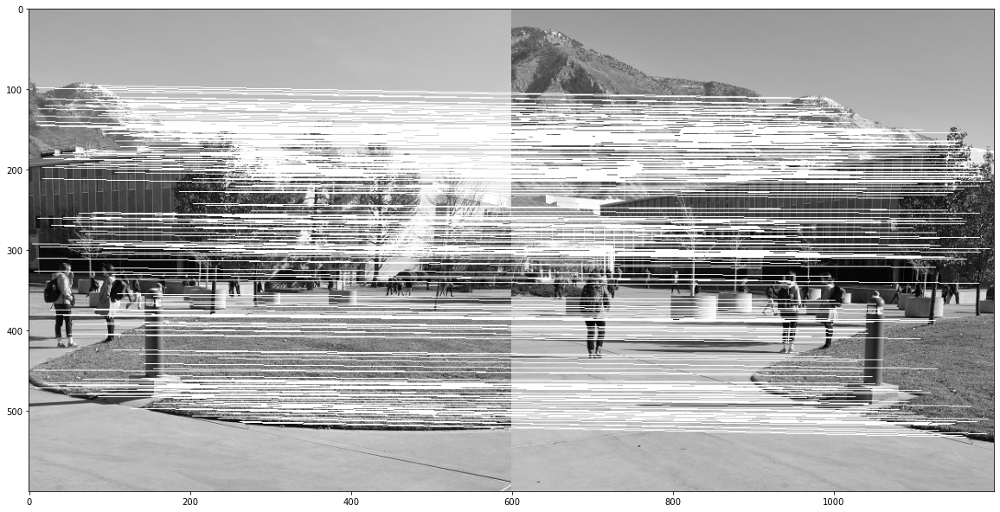

In [89]:
x = consensi[0]

x[:,1,0] = x[:,1,0] + 600

img1 = imgs[0]
img2 = imgs[1]

consensus_img = np.zeros((600,1200))
consensus_img[:,:600] = cv.cvtColor(img1[:,:,::-1], cv.COLOR_BGR2GRAY)
consensus_img[:,600:] = cv.cvtColor(img2[:,:,::-1], cv.COLOR_BGR2GRAY)

for pt1, pt2 in x:
    cv.line(consensus_img, tuple(pt1), tuple(pt2), (255,255,255), 1)
    
plt.imshow(consensus_img, cmap="gray")
plt.show()

x = consensi[1]

x[:, 1, 0] = x[:, 1, 0] + 600

img1 = imgs[2]
img2 = imgs[1]

consensus_img = np.zeros((600,1200))
consensus_img[:,:600] = cv.cvtColor(img1[:,:,::-1], cv.COLOR_BGR2GRAY)
consensus_img[:,600:] = cv.cvtColor(img2[:,:,::-1], cv.COLOR_BGR2GRAY)

for pt1, pt2 in x:
    cv.line(consensus_img, tuple(pt1), tuple(pt2), (255,255,255), 1)
print("Consensus Sets")
print("-"*20)
plt.imshow(consensus_img, cmap="gray")
plt.show()


### Part D: Creating the Mosaic

401 81 1826 832
401 81 750 1424
[[-401  -81]
 [ 281    0]
 [ 311  573]
 [-360  628]]
[[ 309   28]
 [1023  -77]
 [ 997  669]
 [ 298  593]]
[[  0   0]
 [600   0]
 [600 600]
 [  0 600]]


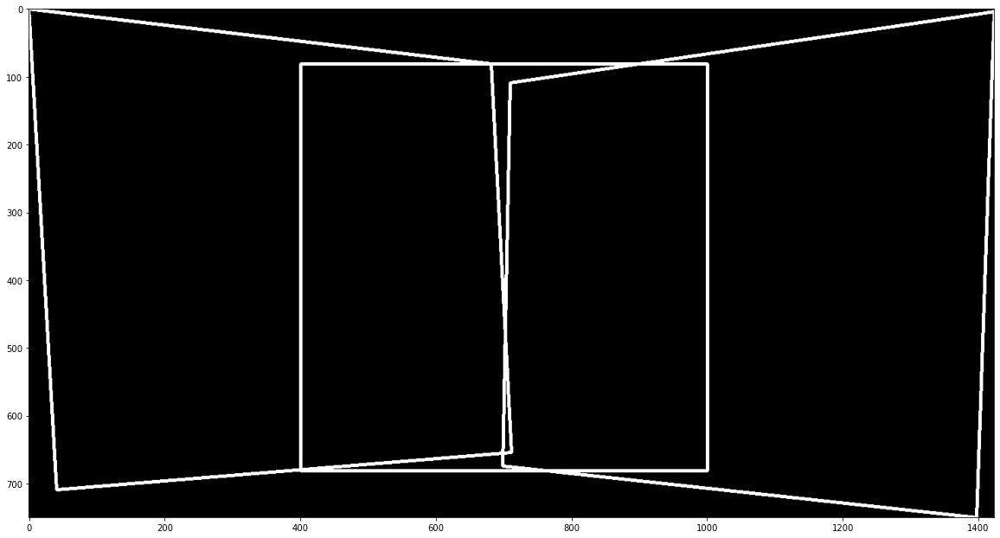

In [90]:
def src_dest_points(imgid, H):
    if type(imgid) == type(1):
        img = imgs[imgid]
    else:
        img = imgid
    img_h, img_w, img_p = img.shape
    src_points = np.array([[0, 0], [0, img_w], [img_h, 0], [img_h, img_w]])
    dest_points = homography_points(H, src_points)
    return src_points, dest_points

src_pts_01, dest_pts_01 = src_dest_points(0, Hs[0])
src_pts_21, dest_pts_21 = src_dest_points(2, Hs[1])

src = src_pts_01.copy()
dest = dest_pts_01.copy()
dest2 = dest_pts_21.copy()

dests = np.append(dest, dest2, axis=0).astype(int)
dests = np.append(dests, src, axis=0).astype(int)
#print(dests)

dx, dy, w, h = cv.boundingRect(dests)
dy, dx = 0-dy, 0-dx
w+=dx
h+=dy
print(dx, dy, w, h)

xmin = min(dests[:,0])
xmax = max(dests[:,0])
ymin = min(dests[:,1])
ymax = max(dests[:,1])
w = xmax-xmin
h = ymax-ymin
dx = 0-xmin
dy = 0-ymin

print(dx, dy, h, w)

test_img = np.zeros((h,w))
for i in range(1,4):
    end = i*4
    start = end - 4
    pts = dests[start:end]
    pts = np.array([pts[0],pts[2],pts[3],pts[1]])
    print(pts)
    ind = 0
    for _ in range(4):
        next = (ind + 1) % 4
        from_ = pts[ind] + np.array([dx, dy])
        to_ = pts[next] + np.array([dx, dy])
        ind = next
        
        cv.line(test_img, tuple(from_), tuple(to_), (255,255,255), 3)
plt.imshow(test_img, cmap="gray")

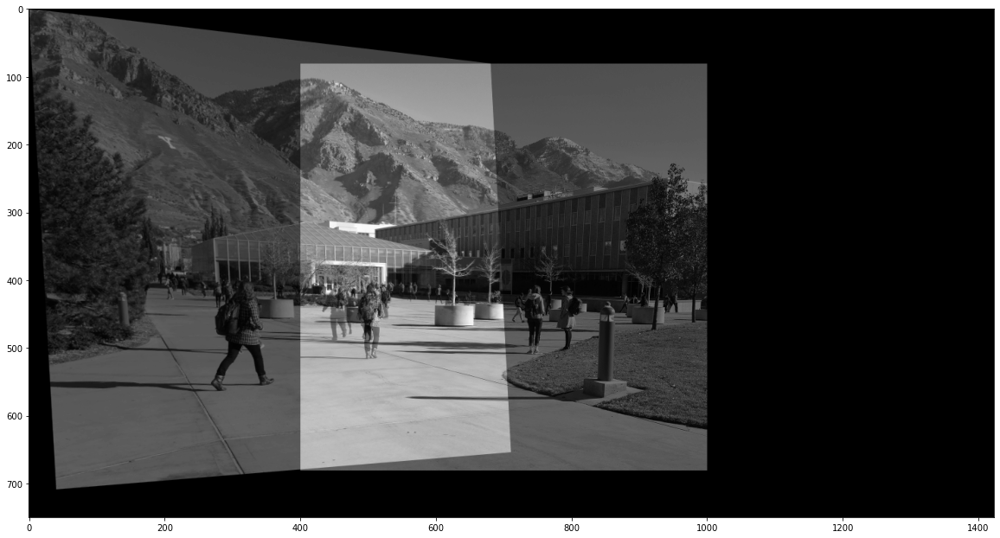

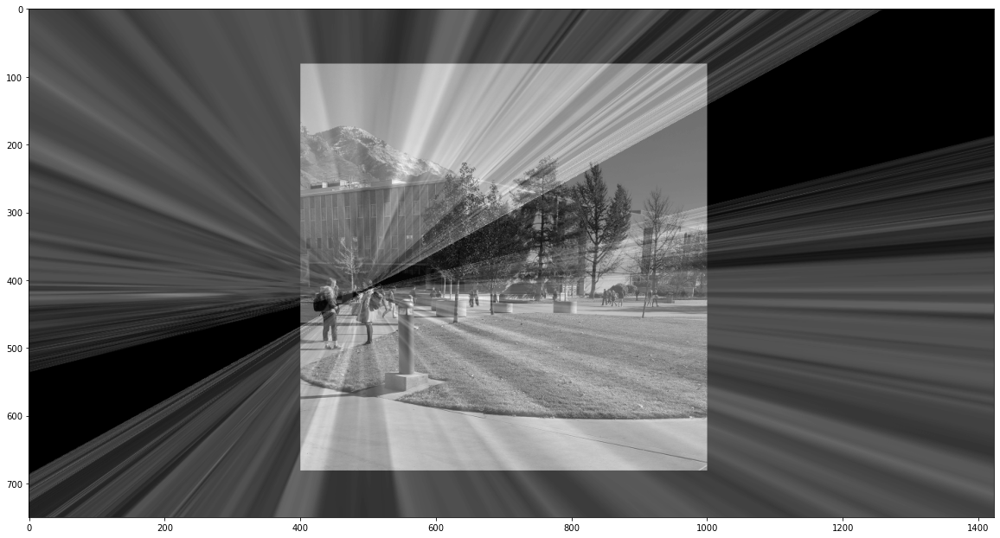

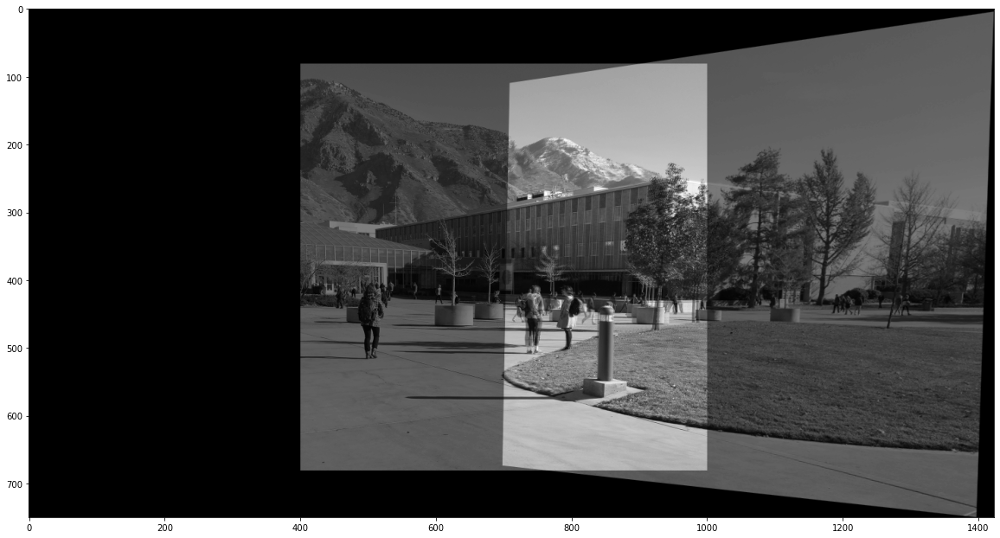

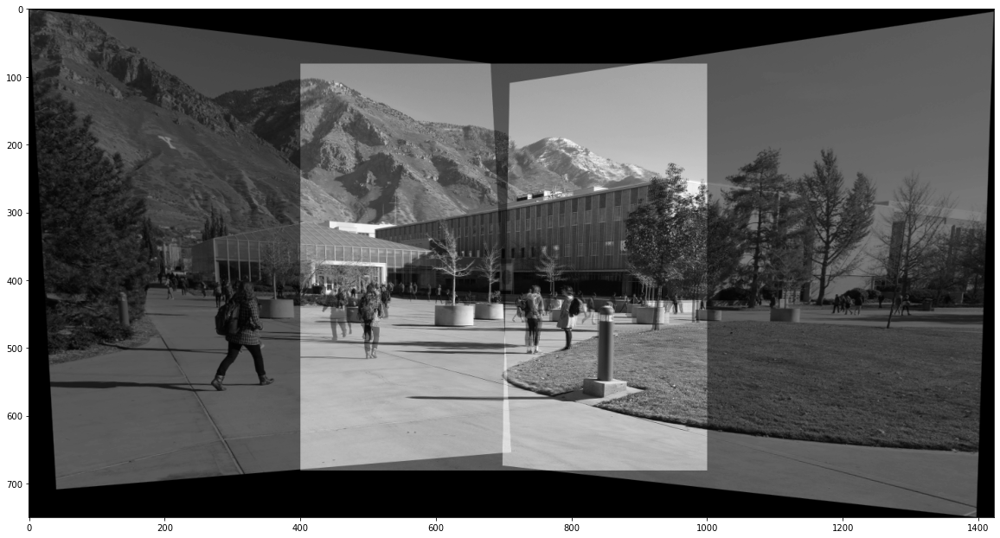

In [91]:
resmatrix_src = np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]).astype(np.float32)
gray_img = cv.cvtColor(imgs[1][:, :, ::-1], cv.COLOR_BGR2GRAY)
resImg_src = cv.warpPerspective(gray_img, resmatrix_src, (w, h))

resImg_2 = np.array(
    [[1, 0, dx], [0, 1, dy], [0, 0, 1]]).astype(np.float32)
gray_img = cv.cvtColor(imgs[2][:, :, ::-1], cv.COLOR_BGR2GRAY)
resImg_2 = cv.warpPerspective(gray_img, resImg_2, (w, h))

resmatrix01 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[0])
gray_img = cv.cvtColor(imgs[0][:, :, ::-1], cv.COLOR_BGR2GRAY)
resImg01 = cv.warpPerspective(gray_img, resmatrix01, (w, h))
comb01 = cv.addWeighted(resImg01, 0.5, resImg_src, 0.5, 0)
plt.imshow(comb01, cmap="gray")
plt.show()

resmatrix02 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[2])
gray_img = cv.cvtColor(imgs[0][:, :, ::-1], cv.COLOR_BGR2GRAY)
resImg02 = cv.warpPerspective(gray_img, resmatrix02, (w, h))
comb02 = cv.addWeighted(resImg02, 0.5, resImg_2, 0.5, 0)
plt.imshow(comb02, cmap="gray")
plt.show()

resmatrix21 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[1])
gray_img = cv.cvtColor(imgs[2][:, :, ::-1], cv.COLOR_BGR2GRAY)
resImg21 = cv.warpPerspective(gray_img, resmatrix21, (w, h))
comb21 = cv.addWeighted(resImg21, 0.5, resImg_src, 0.5, 0)
plt.imshow(comb21, cmap="gray")
plt.show()

blended_img = cv.addWeighted(resImg01, 1, resImg21, 1, 0)
blended_img = cv.addWeighted(blended_img, 0.5, resImg_src, 0.5, 0)
plt.imshow(blended_img, cmap="gray")


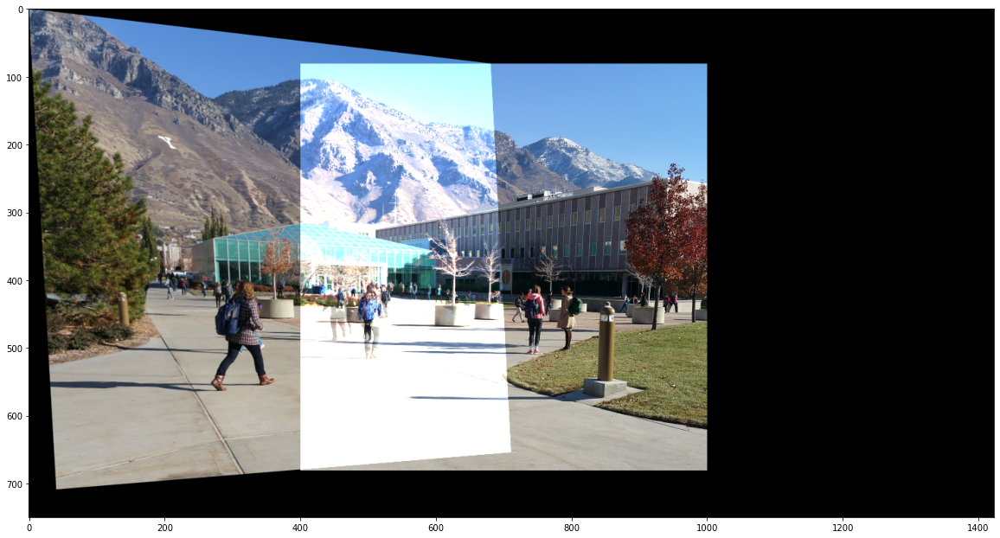

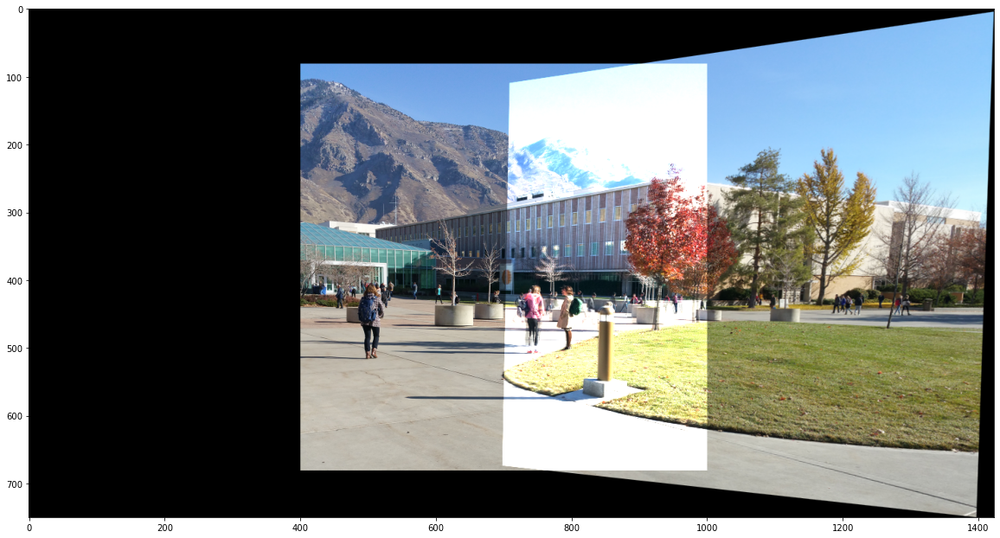

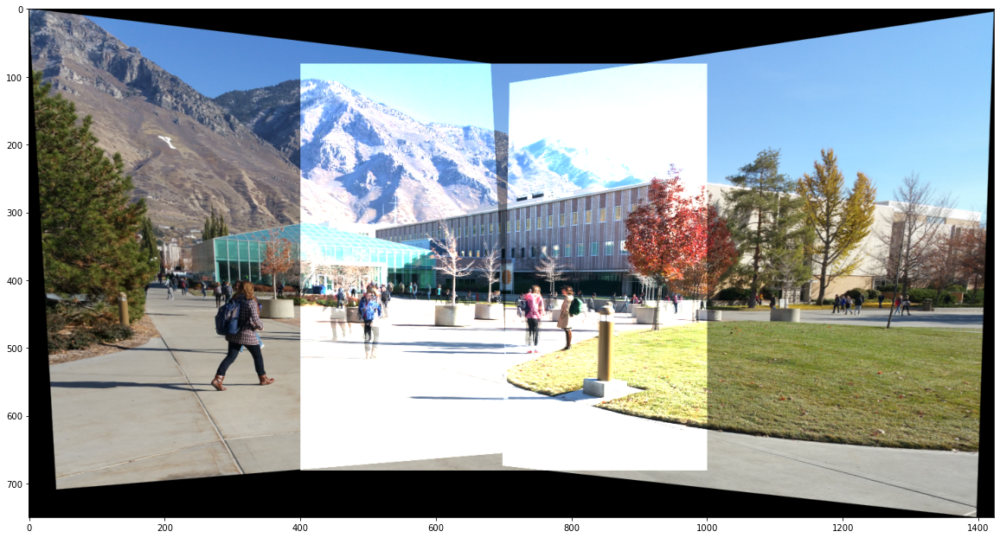

In [92]:
resmatrix_src = np.array(
    [[1, 0, dx], [0, 1, dy], [0, 0, 1]]).astype(np.float32)
color_img = imgs[1].copy()
resImg_src = cv.warpPerspective(color_img, resmatrix_src, (w, h))

resmatrix01 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[0])
color_img = imgs[0].copy()
resImg01 = cv.warpPerspective(color_img, resmatrix01, (w, h))
comb01 = cv.addWeighted(resImg01, 1, resImg_src, 1, 0)
plt.imshow(comb01, cmap="gray")
plt.show()

resmatrix21 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[1])
color_img = imgs[y].copy()
resImg21 = cv.warpPerspective(color_img, resmatrix21, (w, h))
comb21 = cv.addWeighted(resImg21, 1, resImg_src, 1, 0)
plt.imshow(comb21, cmap="gray")
plt.show()

blended_img = cv.addWeighted(resImg01, 1, resImg21, 1, 0)
blended_img = cv.addWeighted(blended_img, 1, resImg_src, 1, 0)
#blended_img[dy:600+dy, dx:600+dx] = imgs[1]

plt.imshow(blended_img, cmap="gray")


Finding the homography _. _____. __. . . . . _. . . . . . . . . . . . _.  Finished
576 280
Finding the homography _. ___. . . _. . . _. . . . . . . . . . . . .  Finished
548 230


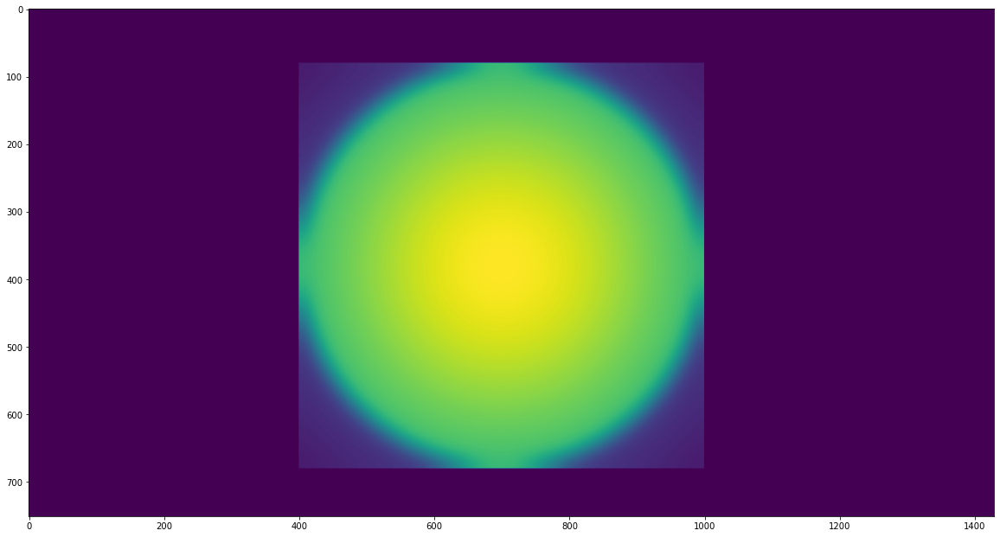

In [93]:
def blur_together(merged, left, center, right, new_centers, show_gauss=False):
    
    left_bin = cv.cvtColor(left, cv.COLOR_BGR2GRAY)
    thing, left_bin = cv.threshold(left_bin, 1, 255, cv.THRESH_BINARY)
    center_bin = cv.cvtColor(center, cv.COLOR_BGR2GRAY)
    thing, center_bin = cv.threshold(center_bin, 1, 255, cv.THRESH_BINARY)
    right_bin = cv.cvtColor(right, cv.COLOR_BGR2GRAY)
    thing, right_bin = cv.threshold(right_bin, 1, 255, cv.THRESH_BINARY)

    left_bin = cv.GaussianBlur(left_bin, ksize=(3,3), sigmaX=100)
    #center_bin = cv.GaussianBlur(center_bin, ksize=(3,3), sigmaX=100)
    right_bin = cv.GaussianBlur(right_bin, ksize=(3, 3), sigmaX=100)

    m, n, p = img1.shape
    x, y = np.meshgrid(np.linspace(-1, 1, m), np.linspace(-1, 1, n))
    dst = np.sqrt(x*x+y*y)
    sigma = 0.7
    muu = 0.000
    gauss = np.exp(-((dst-muu)**2 / (2.0 * sigma**2)))
    low_thresh = gauss[0,len(gauss[0])//2]
    thing, gauss_bin = cv.threshold(gauss, low_thresh, 1, cv.THRESH_BINARY)
    new_gauss = (gauss+gauss_bin)/2
    for _ in range(50):
        new_gauss = cv.GaussianBlur(new_gauss, ksize=(7,7), sigmaX=100)

    xmin = min(new_centers[:, 1])
    xmax = max(new_centers[:, 1])
    ymin = min(new_centers[:, 0])
    ymax = max(new_centers[:, 0])

    gauss2_img = np.zeros((left_bin.shape[:2]))
    gauss2_img[ymin:ymax, xmin:xmax] = new_gauss
    
    if show_gauss:
        plt.imshow(gauss2_img)
        plt.show()
    
    merge_cpy = deepcopy(merged)
    
    for i, row in enumerate(merge_cpy):
        for j, pixel in enumerate(row):
            if center_bin[i][j] == 255 and left_bin[i][j] == 255:
                merge_cpy[i][j] = left[i][j]*(1-gauss2_img[i][j]) + center[i][j]*gauss2_img[i][j]
            elif center_bin[i][j] == 255 and right_bin[i][j] == 255:
                merge_cpy[i][j] = right[i][j]*(1-gauss2_img[i][j]) + center[i][j]*(gauss2_img[i][j])
            elif center_bin[i][j] == 255:
                merge_cpy[i][j] = center[i][j]*0.8+merge_cpy[i][j]*0.2
                
    return merge_cpy


def img_merge(img0, img1, img2, keepcenter=True, show_gauss=False):
    """
    Merge three images together based on the center image that is passed in. It does this by using a SIFT
    detector to find invariant features in each images. It then uses the RANSAC algorithm to select
    random sets of four points, compute a homography, and then do this 1000 times with random
    point each time to compute a consensus set. From this consenus set it then used a least-squares solver
    to find a homography matrix that fits all of those consensus points. Finally, it warps these images
    to the base image and then merges them together. Finally, it blurs these images together using a
    gaussian distribution.
    """
    m,n,p = img1.shape
    
    sift = cv.SIFT_create()
    kp0, des0 = sift.detectAndCompute(img0, None)
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    
    bf = cv.BFMatcher(cv.NORM_L1, crossCheck=True)
    match01 = bf.match(des0, des1)
    match21 = bf.match(des2, des1)
    
    H01, cons01 = ransac_homography(match01, kp0, kp1)
    H21, cons21 = ransac_homography(match21, kp2, kp1)
    
    src_pts_01, dest_pts_01 = src_dest_points(img0, H01)
    src_pts_21, dest_pts_21 = src_dest_points(img2, H21)
    src = src_pts_01.copy()
    dest = dest_pts_01.copy()
    dest2 = dest_pts_21.copy()
    dests = np.append(dest, dest2, axis=0).astype(int)
    dests = np.append(dests, src, axis=0).astype(int)
    
    xmin = min(dests[:, 0])
    xmax = max(dests[:, 0])
    ymin = min(dests[:, 1])
    ymax = max(dests[:, 1])
    w = xmax-xmin
    h = ymax-ymin
    dx = 0-xmin
    dy = 0-ymin
    
    new_centers = np.array([[0,0], [0,n], [m,0], [m,n]])
    for i, arr in enumerate(new_centers):
        new_centers[i] = arr + np.array([dy, dx])
    
    Tsrc = np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]).astype(np.float32)
    img_src = cv.warpPerspective(img1, Tsrc, (w,h))
    
    T01 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), H01)
    img_01 = cv.warpPerspective(img0, T01, (w,h))
    
    T21 = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), H21)
    img_21 = cv.warpPerspective(img2, T21, (w,h))
    
    blended = cv.addWeighted(img_01, 1, img_21, 1, 0)
    blended = cv.addWeighted(blended, 1, img_src, 1, 0)
    if keepcenter:
        blended[dy:dy+m,dx:dx+n] = img1
        
    blurred = blur_together(blended, img_01, img_src, img_21, new_centers, show_gauss=show_gauss)
    
    return blended, blurred


proj_merge, proj_merge_blurr = img_merge(
    imgs[0], imgs[1], imgs[2], show_gauss=True)



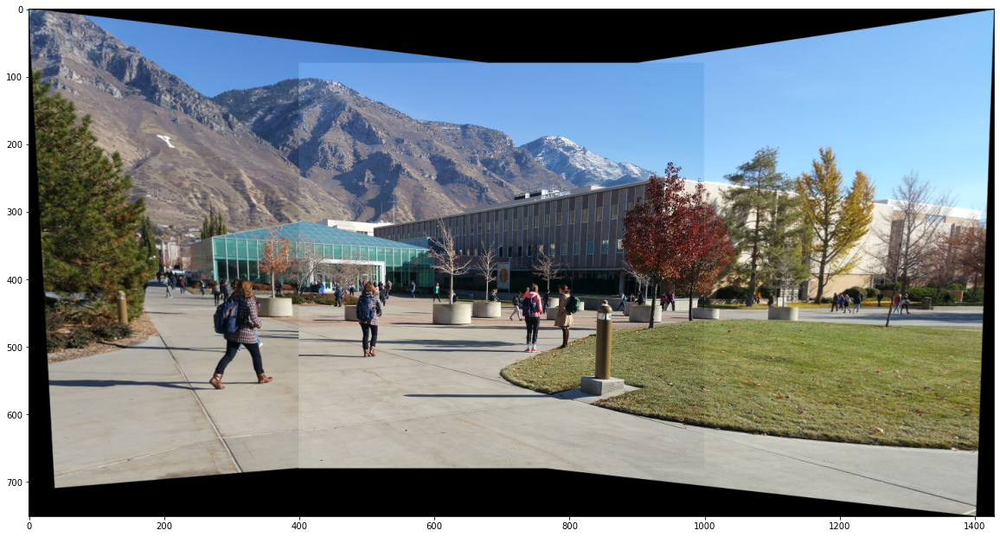

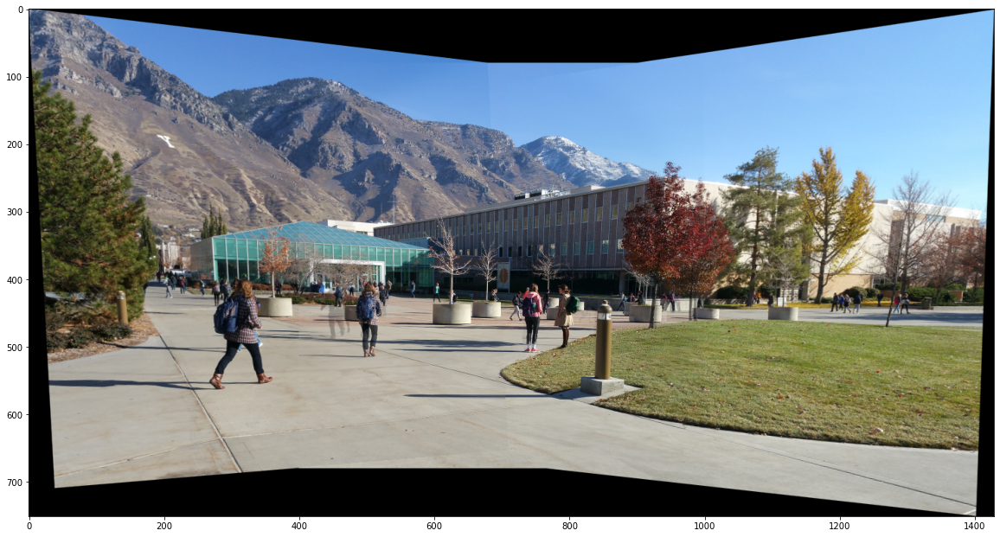

In [94]:
plt.imshow(proj_merge)
plt.show()
plt.imshow(proj_merge_blurr)
plt.show()


### Final Results and Improvements

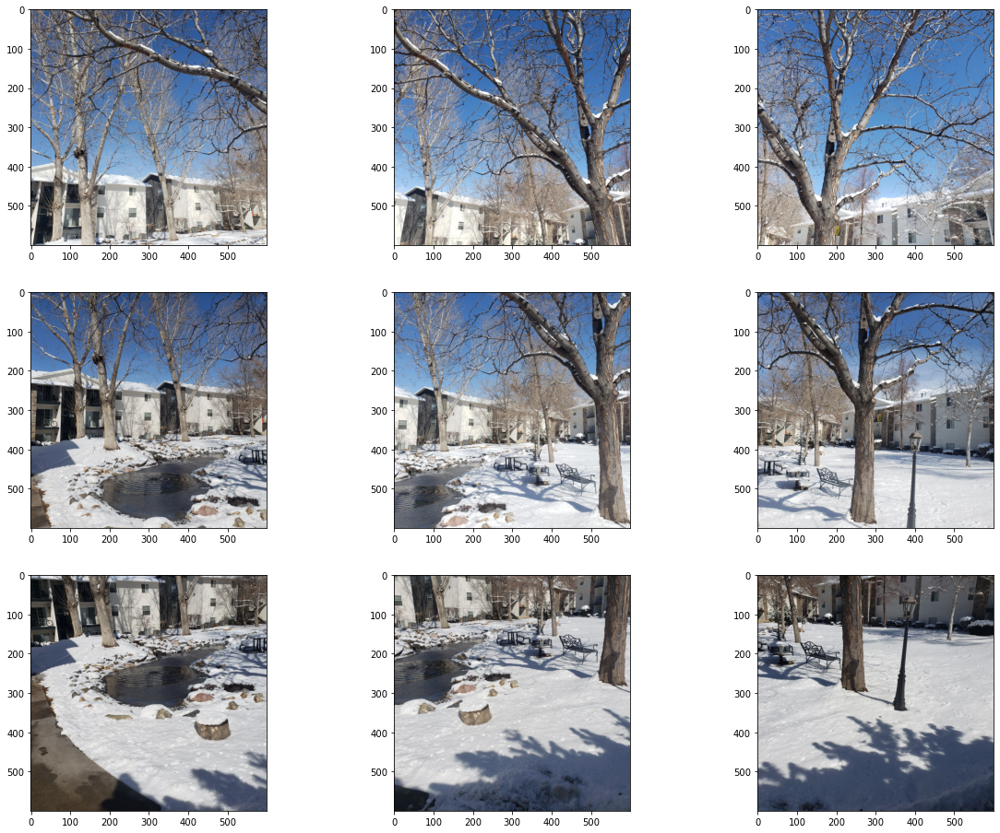

In [109]:
def get_img_1200(name):
    img = cv.imread("images/pano9/" + str(name) + ".jpg")
    img = cv.resize(img, (1200, 1200), interpolation=cv.INTER_AREA)
    return img[:,:,::-1]

def get_img_600(name):
    img = cv.imread("images/pano9/" + str(name) + ".jpg")
    img = cv.resize(img, (600, 600), interpolation=cv.INTER_AREA)
    return img[:,:,::-1]
    
ll = get_img_600("ll")
cc = get_img_600("cc")
rr = get_img_600("rr")
uu = get_img_600("uu")
dd = get_img_600("dd")
ul = get_img_600("ul")
ur = get_img_600("ur")
dl = get_img_600("dl")
dr = get_img_600("dr")

def plot_img(img, dim=(5,5)):
    f = plt.figure()
    f.set_figwidth(dim[0])
    f.set_figheight(dim[1])
    plt.imshow(img)
    plt.show()

plt.subplot(331)
plt.imshow(ul)
plt.subplot(332)
plt.imshow(uu)
plt.subplot(333)
plt.imshow(ur)
plt.subplot(334)
plt.imshow(ll)
plt.subplot(335)
plt.imshow(cc)
plt.subplot(336)
plt.imshow(rr)
plt.subplot(337)
plt.imshow(dl)
plt.subplot(338)
plt.imshow(dd)
plt.subplot(339)
plt.imshow(dr)
plt.show()

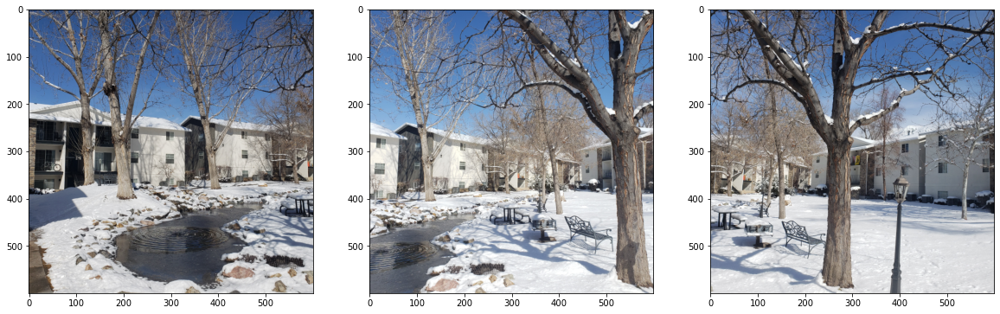

Finding the homography _. . _. . . . . . . . . . . . . . . . . _.  Finished
1204 555
Finding the homography _. . . . . . _. . . . . . . . . . . . . .  Finished
959 59


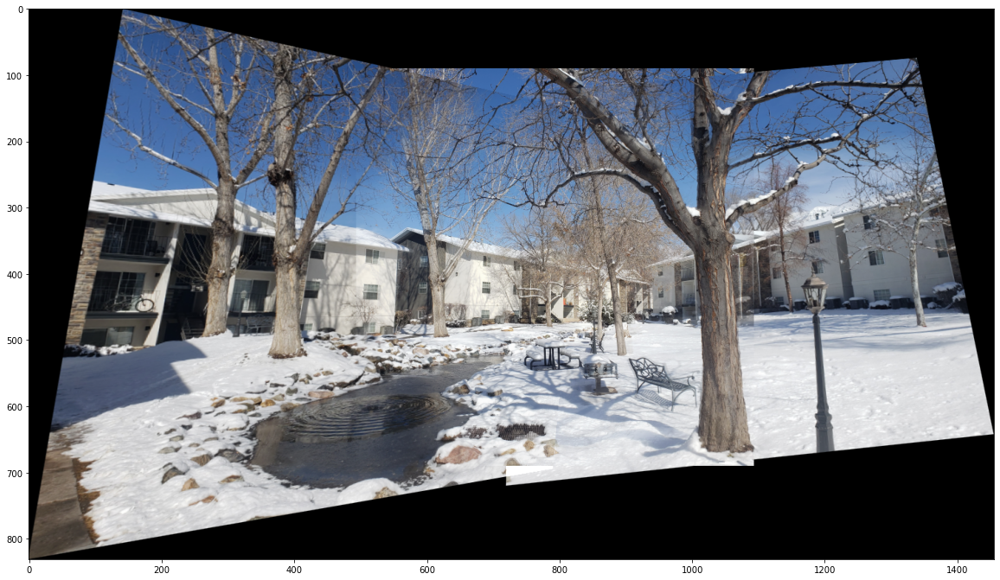

In [115]:
plt.subplot(131)
plt.imshow(ll)
plt.subplot(132)
plt.imshow(cc)
plt.subplot(133)
plt.imshow(rr)
plt.show()

merged_mid, merged_mid_blurr = img_merge(ll,cc,rr)
plt.imshow(merged_mid_blurr)
plt.show()

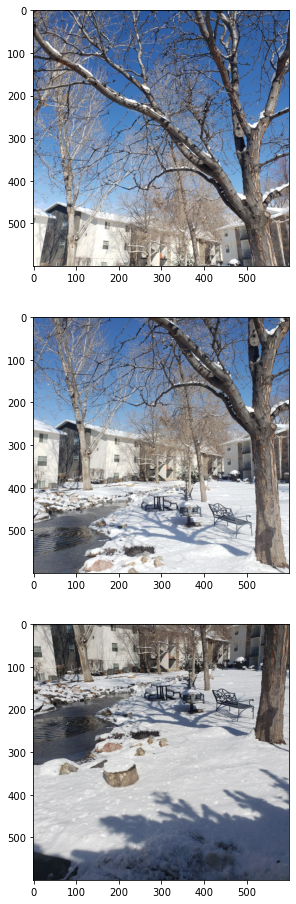

Finding the homography _. ____. . _. . . . . . . . . . . . . . . . .  Finished
1198 599
Finding the homography _. _____. . . . . . . . _. . . . . _. . . . . .  Finished
1204 860


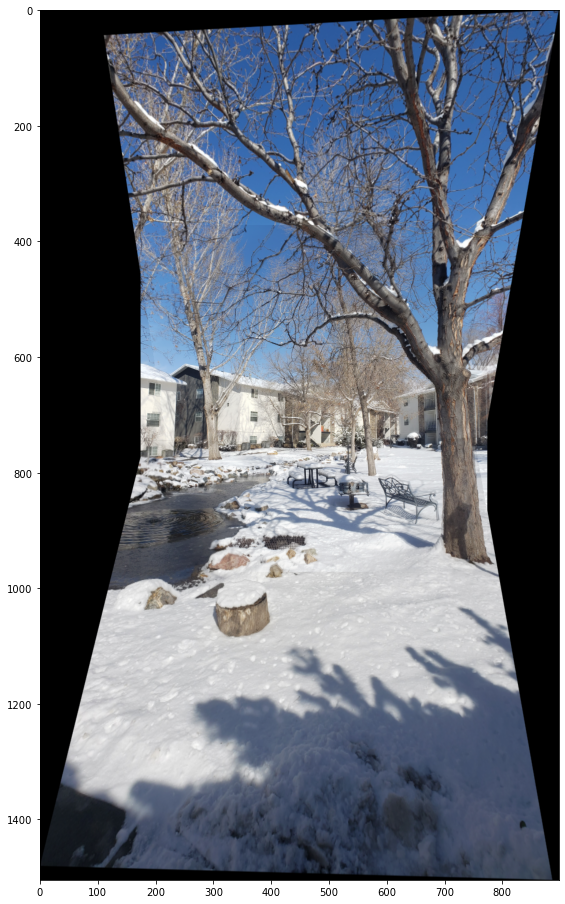

In [114]:
plt.subplot(311)
plt.imshow(uu)
plt.subplot(312)
plt.imshow(cc)
plt.subplot(313)
plt.imshow(dd)
plt.show()

merged_vert, merged_vert_blur = img_merge(uu,cc,dd)
plt.imshow(merged_vert_blur)
plt.show()

Finding the homography _. _. . . . . . . . . . . . . . . . . . .  Finished
1204 585
Finding the homography _. __. . . . . _. _. . _. . . . . . . . . . .  Finished
959 33
Finding the homography _. ___. . . . . _. _. . . . . . . . . . . _. .  Finished
1198 612
Finding the homography _. ___. . _. . . . . . . . . . . . . . . . .  Finished
1204 860


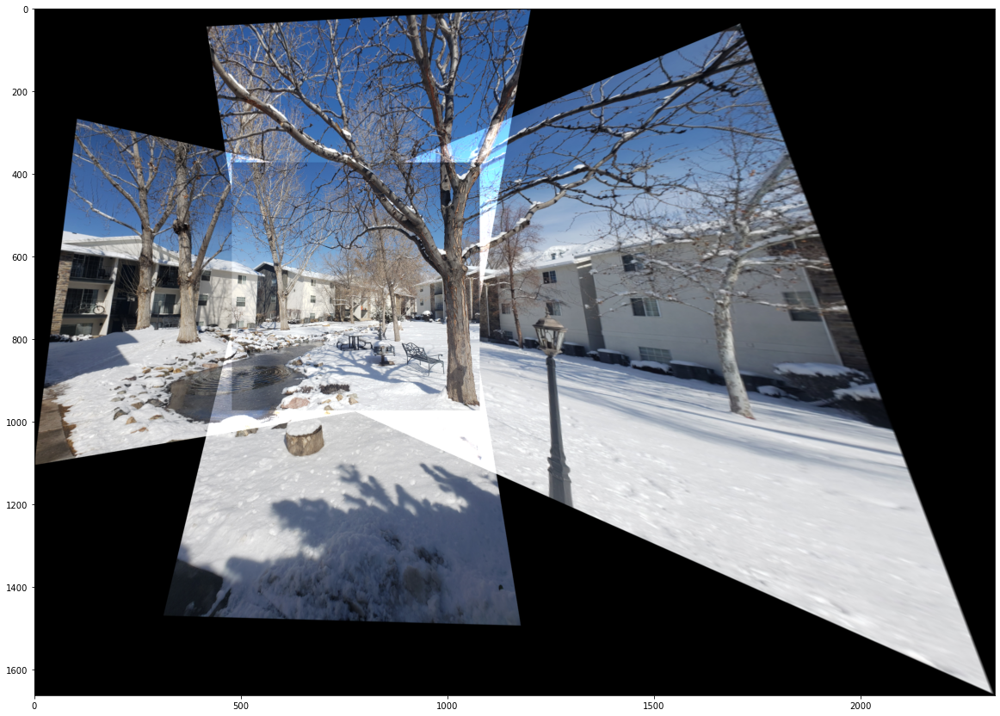

In [107]:
def imgs_merge(base, imgs):
    m,n,p = base.shape
    
    sift = cv.SIFT_create()
    kpb, desb = sift.detectAndCompute(base, None)
    kps, dess = [], []
    for i, img in enumerate(imgs):
        kp0, des0 = sift.detectAndCompute(img, None)
        kps.append(kp0)
        dess.append(des0)
    
    bf = cv.BFMatcher(cv.NORM_L1, crossCheck=True)
    matches = []
    for des in dess:
        matches.append(bf.match(des,desb))
    
    Hs = []
    for i, match in enumerate(matches):
        Hs.append(ransac_homography(match, kps[i], kpb)[0])
    
    
    src_pts = np.array([[0, 0], [0, n], [m, 0], [m, n]])
    dest_pts = []
    for i, img in enumerate(imgs):
        dest_pts.append(src_dest_points(img, Hs[i])[1])
        
    src_pt, dest_pt = src_dest_points(imgs[0], Hs[0])
    dests = np.append(src_pt, dest_pt, axis=0).astype(int)
    for i, img in enumerate(imgs[1:]):
        src, dest = src_dest_points(img, Hs[i])
        dests = np.append(dests, dest, axis=0).astype(int)
    
    xmin = min(dests[:, 0])
    xmax = max(dests[:, 0])
    ymin = min(dests[:, 1])
    ymax = max(dests[:, 1])
    w = xmax-xmin
    h = ymax-ymin
    dx = 0-xmin
    dy = 0-ymin
    
    new_centers = np.array([[0,0], [0,n], [m,0], [m,n]])
    for i, arr in enumerate(new_centers):
        new_centers[i] = arr + np.array([dy, dx])
    
    Tsrc = np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]).astype(np.float32)
    img_src = cv.warpPerspective(base, Tsrc, (w,h))
    
    trans_imgs = []
    for i, img in enumerate(imgs):
        T = np.matmul(np.array([[1, 0, dx], [0, 1, dy], [0, 0, 1]]), Hs[i])
        trans_imgs.append(cv.warpPerspective(img, T, (w,h)))
    
    blended = cv.addWeighted(trans_imgs[0], 1, trans_imgs[1], 1, 0)
    for i, img in enumerate(trans_imgs[2:]):
        blended = cv.addWeighted(blended, 1, img, 1, 0)
    blended = cv.addWeighted(blended, 1, img_src, 1, 0)
    blended[dy:dy+m,dx:dx+n] = base
        
    #blurred = blur_together(blended, img_01, img_src, img_21, new_centers)
    
    return blended

images_4 = [ll, rr, uu, dd]
merged5 = imgs_merge(cc, images_4)
plt.imshow(merged5)
plt.show()



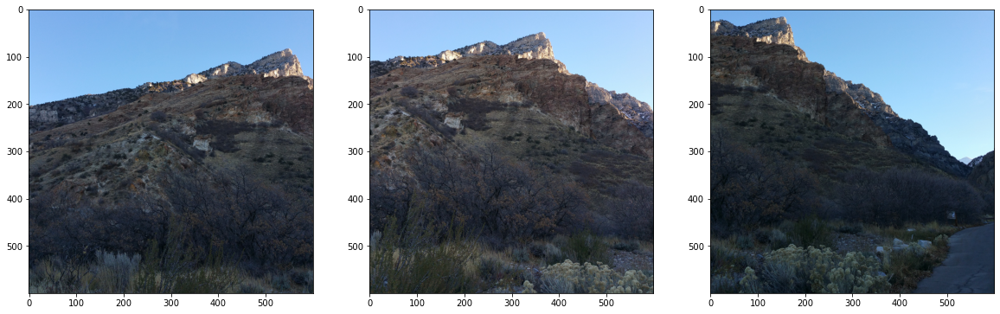

Finding the homography _. ___. . _. . . . . . . . . . . . . . . . .  Finished
643 446
Finding the homography _. ____. _. _. . . . . . . . . . . . . . . . .  Finished
408 265


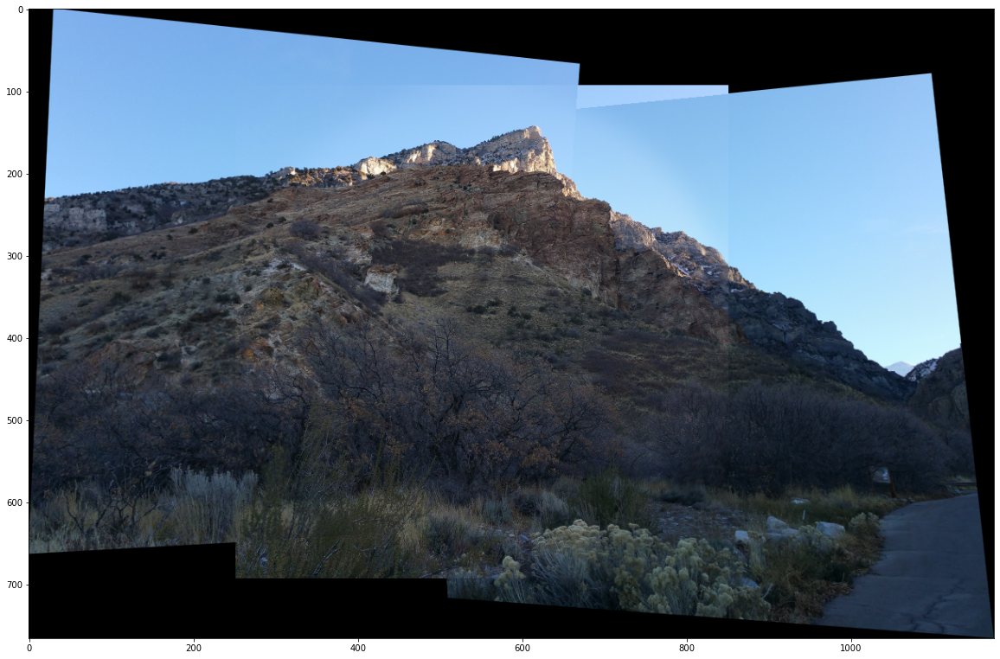

In [103]:
img0 = cv.imread("images/width600/squaw_peak1_sq600.png")[:,:,::-1]
img1 = cv.imread("images/width600/squaw_peak2_sq600.png")[:,:,::-1]
img2 = cv.imread("images/width600/squaw_peak3_sq600.png")[:,:,::-1]

plt.subplot(131)
plt.imshow(img0)
plt.subplot(132)
plt.imshow(img1)
plt.subplot(133)
plt.imshow(img2)
plt.show()

plt.imshow(img_merge(img0, img1, img2)[1])
plt.show()


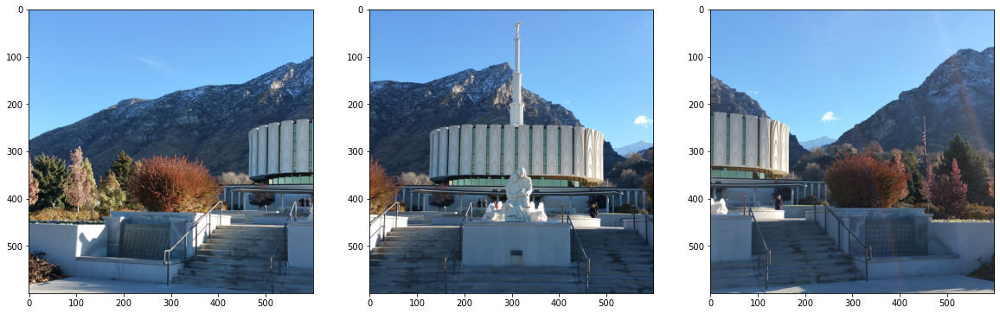

Finding the homography _. _____. . . . . . . . . . _. . _. . . . . . .  Finished
484 295
Finding the homography _. __. . . . _. . . . _. _. . . . . . . . . .  Finished
313 175


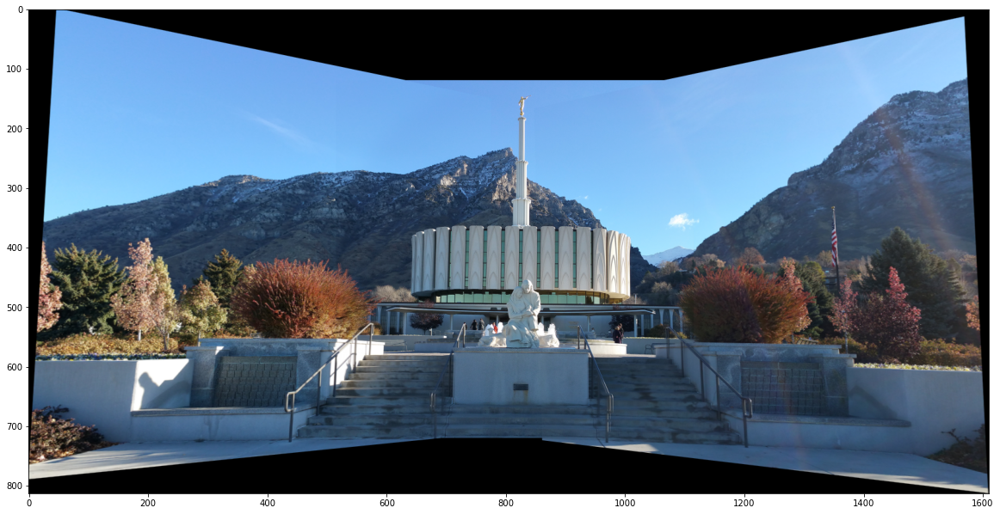

In [105]:
img0 = cv.imread("images/width600/temple_horiz1_sq600.png")[:,:,::-1]
img1 = cv.imread("images/width600/temple_horiz2_sq600.png")[:,:,::-1]
img2 = cv.imread("images/width600/temple_horiz3_sq600.png")[:,:,::-1]


plt.subplot(131)
plt.imshow(img0)
plt.subplot(132)
plt.imshow(img1)
plt.subplot(133)
plt.imshow(img2)
plt.show()


plt.imshow(img_merge(img0, img1, img2)[1])
plt.show()

### Grading

To get 100% you need to (i) implement RANSAC and additionally (ii) either implement the feature matching yourself (instead of using built-in matching functions such as `cv2.BFMatcher()`), or incorporate one of the following improvements:
* A nice clean compositing/blending approach so that edges/artifacts are not noticeable.
* Automatic selection of which image should be the base
* Handling more than 3 photos
* Another enhancement approved by Dr. Farrell

Points for this assigment will be assigned as follows (100 points total):
* [10 pts] Extracting features from both images (interest points and descriptors).
* [20 pts] Four-point algorithm to estimate homographies.
* [30 pts] RANSAC implemented (partial points given for poor alignments).
* [20 pts] Images warped appropriately (aligning on top of each other).
* [10 pts] Clean final image (extents of merged image should fit the enscribed rectangle).
* [10 pts] Implementing matching or other improvement (see above). Bonus points may be given for additional enhancements.

## Write-up:
Provide an explanation for the following items:
* In what scenarios was it difficult to get good alignments between images?
* If you have any suggestions for how to improve this project in the future, list them here.

**Difficult Scenarios:** It was very difficult to get strong alignments when pictures did not have very much in common. I took some of my own photos of the outdoor area of Raintree Apartments (where I live), and most of the photos merged together nicely except for one, since it had only about 26 consensus set points while the other images had around 200 consensus set points. When an image has less features in common, the consensus set is much smaller. I also noticed that when images have lots of very similar patterns to it, there are less distinct features that the program can use. This causes the stitching of images to be more difficult.

**Suggestions:** Honestly, this was a very straight-forward and fun project. The only thing that I would explain a little better or have a small comment about is how to use the cv2.warpPerspective() function, since this was the only part that had a very large learning curve. Everything else seemed to come together smoothly.

**My implementations:** To perform the blurring between images, I generated a matrix filled with a Gaussian distribution. I then used this Gaussian distribution as the proportions that should be balanced between the center image and the combined images. I used binary versions of each of the left and right images to determine when I should merge the right/center images or the left/center images.

I implemented the multiple images portion by setting one of the images to the base image and then merging all of the other images to this base image. I basically performed the normal algorithm for merging three images, but used a list of images instead of just two separate images.